In [70]:
from datasetsforecast.m4 import M4

M4.download("/home/pranav-pc/data/")
df = M4.load("/home/pranav-pc/data/", group="Daily")[0]
df.head()

,unique_id,ds,y
0,D1,1,1017.1
1,D1,2,1019.3
2,D1,3,1017.0
3,D1,4,1019.2
4,D1,5,1018.7


In [71]:
import random

unique_ids = df.unique_id.unique()


def get_random_df(unique_ids):
    random.choice(unique_ids)
    ds = df[df.unique_id == random.choice(unique_ids)]
    ds.reset_index(drop=True, inplace=True)
    return ds


ds = get_random_df(unique_ids)
ds.shape

(3205, 3)

In [72]:
W = 30  # window length in samples per segment (adjust to your sampling/time granularity)
ds = ds.iloc[len(ds) % W :].reset_index()

In [73]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import plotly.graph_objects as go
import torch
import torch.nn as nn
from plotly.subplots import make_subplots
from scipy.fftpack import fft

from ts.models.fft import MovingAvgSinusoidalDecompose
from ts.stats.dynamic_thresholds import centered_moving_average, select_kernel_for_trend
from ts.utils.plot import plot_decomposition

In [74]:
kernel_size_trend = select_kernel_for_trend(ds.y.values, threshold_ratio=0.15)["selected_k"] // 8
kernel_size_trend

99

In [75]:
x = torch.tensor(ds.y.values).float().view(1, 1, -1)  # shape: (B, C, T)
model = MovingAvgSinusoidalDecompose(
    kernel_size_trend=kernel_size_trend + 1 if kernel_size_trend % 2 == 0 else kernel_size_trend,
    energy_threshold=0.80,
)
seasonal_forecast, (trend, seasonal, noise) = model(x, period=int(len(ds) * 0.2))
plot_decomposition(x.flatten(), trend.flatten(), seasonal.flatten(), noise.flatten())

torch.Size([1, 1, 3816]) 636
torch.Size([1, 1, 3180]) torch.Size([1, 1, 3180])


Features shape: (30, 3)
Feature std per column: [1. 1. 1.]
Assigned states: (array([0, 1, 2]), array([ 8,  9, 13]))
Detected state period (segments): None
N points: 3180
Segments: 30 seg_len (approx): 106
Detected state period: None
Recent segments weighted (x): 30
State residual means (per-state): [-20.768094  10.725775   3.042764]


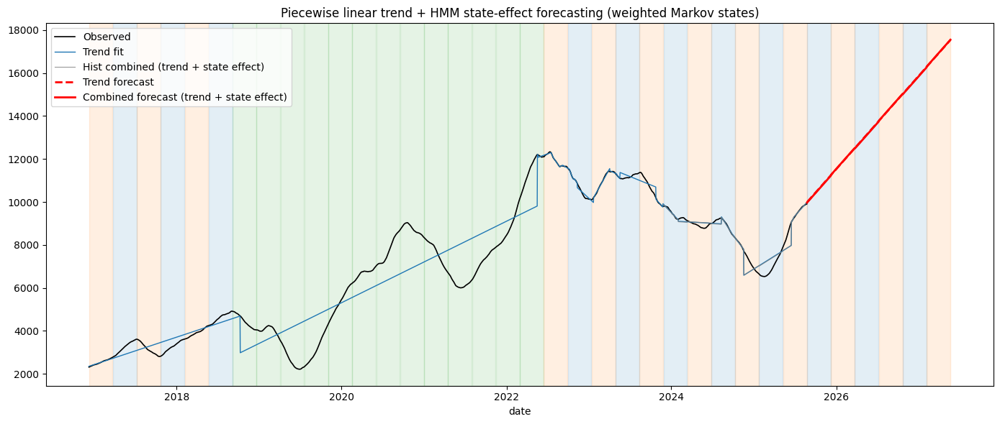

In [76]:
from ts.model.sdm_trend_forecaster import SDMTrendForecaster

trend_forecaster = SDMTrendForecaster(
    n_states=3,
    min_seg_len=3,
    requested_n_segments=30,
    forecast_horizon_ratio=0.2,
    recent_segments=30,
    seed=42,
    n_changepoints=30,
)
trend_forecaster.fit(trend.flatten())
trend_forecaster.print_diagnostics()
trend_forecaster.plot_results()

Features shape: (30, 3)
Feature std per column: [1. 1. 1.]
Assigned states: (array([0, 1, 2]), array([23,  5,  2]))
Detected state period (segments): None


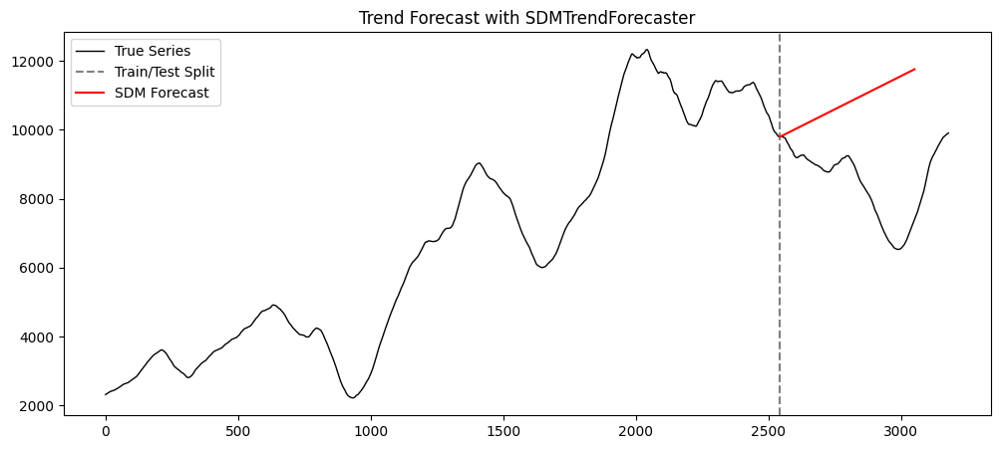

In [77]:
import matplotlib.pyplot as plt
import numpy as np

from ts.model.sdm_trend_forecaster import SDMTrendForecaster

# =====================
# Train / Test Split
# =====================
series = trend.flatten()
n = len(series)
forecast_horizon = int(n * 0.2)
train, test = series[:-forecast_horizon], series[-forecast_horizon:]

# =====================
# Initialize Forecaster
# =====================
trend_forecaster = SDMTrendForecaster(
    n_states=3,
    min_seg_len=3,
    requested_n_segments=30,
    forecast_horizon_ratio=0.2,  # 20% test horizon
    recent_segments=10,
    seed=42,
    n_changepoints=30,
)

# Fit only on train
trend_forecaster.fit(train)


# Forecast horizon length
preds = trend_forecaster.trend_future

# =====================
# Plot Results
# =====================
plt.figure(figsize=(12, 5))
plt.plot(range(len(series)), series, label="True Series", color="black", linewidth=1)
plt.axvline(len(train), color="gray", linestyle="--", label="Train/Test Split")
plt.plot(range(len(train), len(train) + len(preds)), preds, label="SDM Forecast", color="red")
plt.legend()
plt.title("Trend Forecast with SDMTrendForecaster")
plt.show()

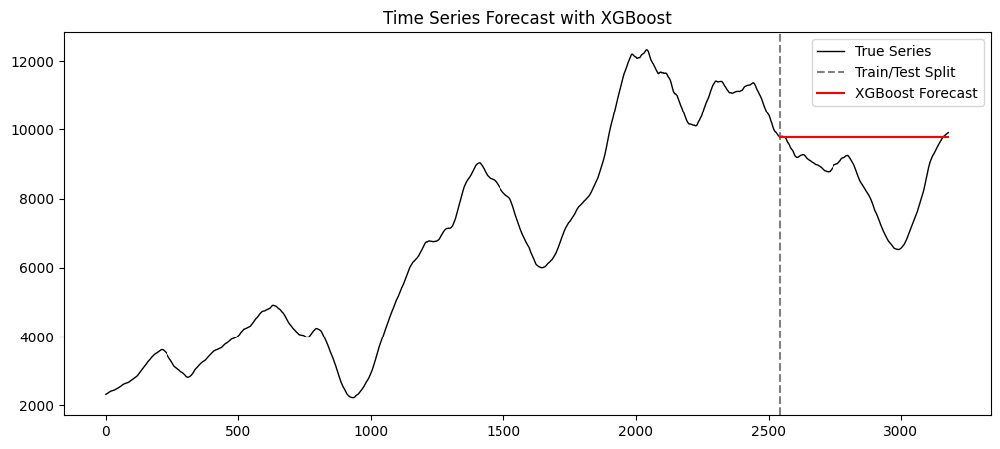

In [78]:
import matplotlib.pyplot as plt
import numpy as np
import xgboost as xgb

# Your series
series = trend.flatten()  # shape (n,)

# Parameters
window_size = 10  # number of lags
forecast_horizon = int(len(series) * 0.2)  # 20% test split

# Prepare supervised dataset
X, y = [], []
for i in range(len(series) - window_size):
    X.append(series[i : i + window_size])
    y.append(series[i + window_size])
X, y = np.array(X), np.array(y)

# Train/test split
train_size = len(X) - forecast_horizon
X_train, X_test = X[:train_size], X[train_size:]
y_train, y_test = y[:train_size], y[train_size:]

# Fit XGBoost regressor
model = xgb.XGBRegressor(objective="reg:squarederror", n_estimators=200)
model.fit(X_train, y_train)

# Forecast iteratively on test set
preds = []
last_window = X_train[-1]

for i in range(len(y_test)):
    pred = model.predict(last_window.reshape(1, -1))[0]
    preds.append(pred)

    # roll the window
    last_window = np.roll(last_window, -1)
    last_window[-1] = pred

# Plot results
plt.figure(figsize=(12, 5))
plt.plot(range(len(series)), series, label="True Series", color="black", linewidth=1)
plt.axvline(len(series) - forecast_horizon, color="gray", linestyle="--", label="Train/Test Split")
plt.plot(
    range(len(series) - forecast_horizon, len(series)),
    preds,
    label="XGBoost Forecast",
    color="red",
)
plt.legend()
plt.title("Time Series Forecast with XGBoost")
plt.show()

Epoch 50/200, Loss=0.021913
Epoch 100/200, Loss=0.001977
Epoch 150/200, Loss=0.001284
Epoch 200/200, Loss=0.000803


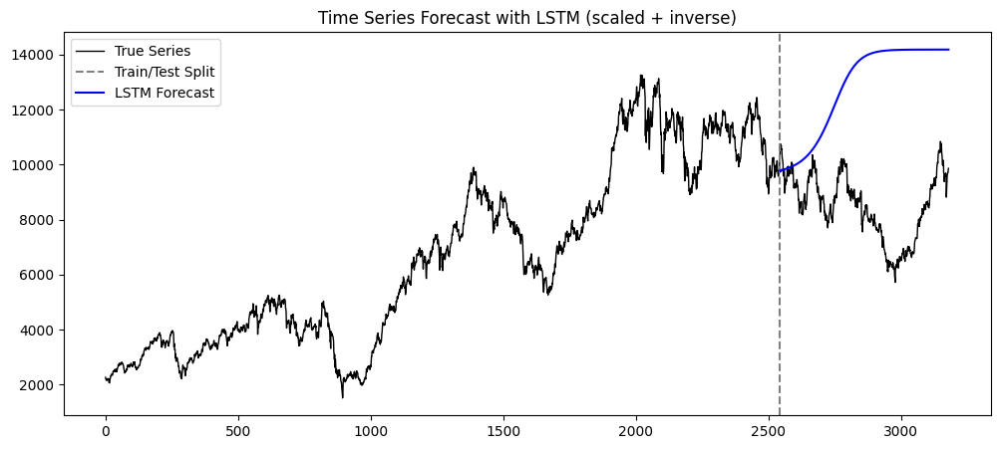

In [79]:
import matplotlib.pyplot as plt
import numpy as np
import torch
import torch.nn as nn
import torch.optim as optim
from sklearn.preprocessing import MinMaxScaler

# =====================
# Data preparation
# =====================
series = trend.flatten().reshape(-1, 1)  # shape (n, 1)

# Scale the series
scaler = MinMaxScaler(feature_range=(0, 1))
train_size = int(len(series) * 0.8)
scaler.fit(series[:train_size])  # fit only on train
series_scaled = scaler.transform(series)

# Parameters
window_size = 10
forecast_horizon = len(series) - train_size

# Prepare supervised dataset
X, y = [], []
for i in range(len(series_scaled) - window_size):
    X.append(series_scaled[i : i + window_size])
    y.append(series_scaled[i + window_size])
X, y = np.array(X), np.array(y)

# Train/test split
X_train, X_test = X[: train_size - window_size], X[train_size - window_size :]
y_train, y_test = y[: train_size - window_size], y[train_size - window_size :]

# Convert to tensors
X_train_t = torch.tensor(X_train, dtype=torch.float32)  # (batch, seq, 1)
y_train_t = torch.tensor(y_train, dtype=torch.float32)  # (batch, 1)
X_test_t = torch.tensor(X_test, dtype=torch.float32)
y_test_t = torch.tensor(y_test, dtype=torch.float32)


# =====================
# LSTM Model
# =====================
class LSTMForecaster(nn.Module):
    def __init__(self, input_size=1, hidden_size=64, num_layers=1):
        super().__init__()
        self.lstm = nn.LSTM(input_size, hidden_size, num_layers, batch_first=True)
        self.fc = nn.Linear(hidden_size, 1)

    def forward(self, x):
        out, _ = self.lstm(x)
        out = self.fc(out[:, -1, :])  # take last step
        return out


model = LSTMForecaster()
criterion = nn.MSELoss()
optimizer = optim.Adam(model.parameters(), lr=0.001)

# =====================
# Training
# =====================
epochs = 200
for epoch in range(epochs):
    model.train()
    optimizer.zero_grad()
    output = model(X_train_t)
    loss = criterion(output, y_train_t)
    loss.backward()
    optimizer.step()
    if (epoch + 1) % 50 == 0:
        print(f"Epoch {epoch+1}/{epochs}, Loss={loss.item():.6f}")


# =====================
# Forecasting (iterative)
# =====================
model.eval()
preds_scaled = []
last_window = torch.tensor(X_train[-1], dtype=torch.float32).unsqueeze(0)

for i in range(len(y_test)):
    with torch.no_grad():
        pred = model(last_window).item()
    preds_scaled.append(pred)

    # roll window
    last_window = torch.roll(last_window, shifts=-1, dims=1)
    last_window[0, -1, 0] = pred

# Inverse transform predictions & ground truth
preds = scaler.inverse_transform(np.array(preds_scaled).reshape(-1, 1)).flatten()
y_test_orig = scaler.inverse_transform(y_test.reshape(-1, 1)).flatten()

# =====================
# Plot results
# =====================
plt.figure(figsize=(12, 5))
plt.plot(range(len(series)), series, label="True Series", color="black", linewidth=1)
plt.axvline(train_size, color="gray", linestyle="--", label="Train/Test Split")
plt.plot(range(train_size, len(series)), preds, label="LSTM Forecast", color="blue")
plt.legend()
plt.title("Time Series Forecast with LSTM (scaled + inverse)")
plt.show()

Polynomial RMSE: 6452621.7980
Spline RMSE: 1624934.8588


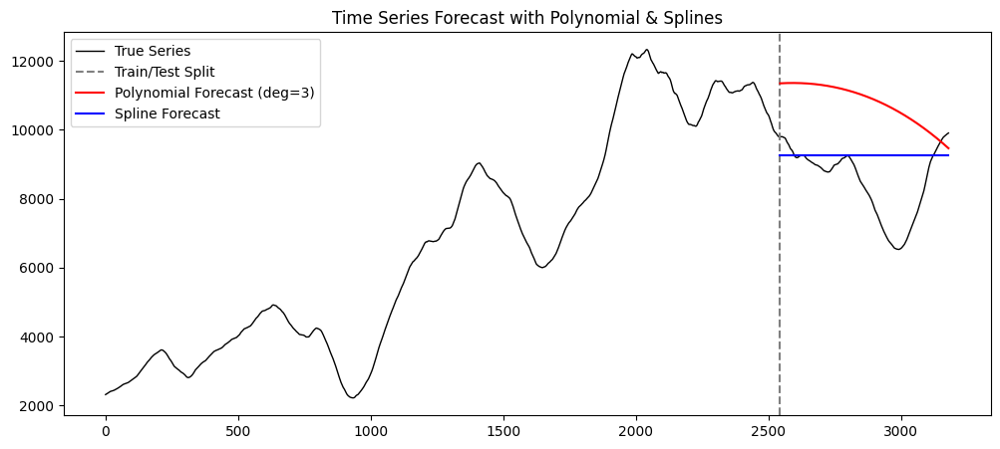

In [80]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.metrics import mean_squared_error
from sklearn.pipeline import make_pipeline
from sklearn.preprocessing import PolynomialFeatures, SplineTransformer

# =====================
# Train / Test Split
# =====================
series = trend.flatten()
n = len(series)
forecast_horizon = int(n * 0.2)
train, test = series[:-forecast_horizon], series[-forecast_horizon:]

# Prepare input features (time index)
X = np.arange(n).reshape(-1, 1)
X_train, X_test = X[:-forecast_horizon], X[-forecast_horizon:]

# =====================
# 1. Polynomial Regression
# =====================
degree = 3  # you can tune
poly_model = make_pipeline(PolynomialFeatures(degree), LinearRegression())
poly_model.fit(X_train, train)
poly_preds = poly_model.predict(X_test)

# =====================
# 2. Splines (Cubic)
# =====================
spline_model = make_pipeline(
    SplineTransformer(degree=3, n_knots=10, knots="uniform"), LinearRegression()
)
spline_model.fit(X_train, train)
spline_preds = spline_model.predict(X_test)

# =====================
# Evaluation
# =====================
poly_rmse = mean_squared_error(test, poly_preds)
spline_rmse = mean_squared_error(test, spline_preds)
print(f"Polynomial RMSE: {poly_rmse:.4f}")
print(f"Spline RMSE: {spline_rmse:.4f}")

# =====================
# Plot Results
# =====================
plt.figure(figsize=(12, 5))
plt.plot(X, series, label="True Series", color="black", linewidth=1)
plt.axvline(len(train), color="gray", linestyle="--", label="Train/Test Split")
plt.plot(X_test, poly_preds, label=f"Polynomial Forecast (deg={degree})", color="red")
plt.plot(X_test, spline_preds, label="Spline Forecast", color="blue")
plt.legend()
plt.title("Time Series Forecast with Polynomial & Splines")
plt.show()

In [81]:
### Novel

In [82]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.optim as optim
from scipy import signal, stats
from sklearn.cluster import AgglomerativeClustering, KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

In [83]:
# ---------------------------
# Segment feature helpers
# ---------------------------


def window_slices(y, W):
    n = len(y)
    m = n // W
    return [y[i * W : (i + 1) * W] for i in range(m)]


def ols_slope_r2(x, t):
    t = (t - t.mean()) / (t.std() + 1e-12)
    b1, b0, r, p, _ = stats.linregress(t, x)
    return b1, r * r, p


def lag1_acf(x):
    x = np.asarray(x)
    x = (x - x.mean()) / (x.std() + 1e-12)
    return float(np.dot(x[:-1], x[1:]) / (len(x) - 1))


def quadratic_fit(x):
    t = np.arange(len(x))
    coeffs = np.polyfit(t, x, 2)  # quadratic fit
    a, b, c = coeffs
    return a, b, c  # keep full coefficients


def monotonicity_ratio(x):
    diffs = np.diff(x)
    return np.mean(diffs > 0)


def spectral_entropy(x):
    f, Pxx = signal.periodogram(x, scaling="spectrum")
    P = Pxx + 1e-12
    P /= P.sum()
    H = -(P * np.log(P)).sum()
    H /= np.log(len(P))
    return float(H)


def trend_strength(x):
    t = np.arange(len(x))
    slope, intercept, _, _, _ = stats.linregress(t, x)
    fit = slope * t + intercept
    resid_var = np.var(x - fit)
    total_var = np.var(x)
    return 1 - resid_var / (total_var + 1e-12)


def kendall_tau(x):
    tau, _ = stats.kendalltau(np.arange(len(x)), x)
    return 0.0 if np.isnan(tau) else float(tau)


# ---------------------------
# Segment-level features
# ---------------------------


def segment_features(seg):
    seg = np.asarray(seg)
    t = np.arange(len(seg))
    mu = float(np.mean(seg))
    med = float(np.median(seg))
    std = float(np.std(seg, ddof=1)) if len(seg) > 1 else 0.0
    rng = float(np.max(seg) - np.min(seg)) if len(seg) else 0.0
    iqr = float(np.subtract(*np.percentile(seg, [75, 25]))) if len(seg) else 0.0
    mad = float(np.median(np.abs(seg - med)))
    cv = float(std / (abs(mu) + 1e-12))

    b1, r2, pval = ols_slope_r2(seg, t)
    fit = b1 * ((t - t.mean()) / (t.std() + 1e-12)) + (seg.mean() - b1 * 0)
    resid_std = float(np.std(seg - fit, ddof=1)) if len(seg) > 1 else 0.0

    acf1 = lag1_acf(seg)
    ret = np.diff(seg)
    rv = float(np.std(ret, ddof=1)) if len(ret) > 1 else 0.0
    tau = kendall_tau(seg)
    sent = spectral_entropy((seg - mu) / (std + 1e-12))

    # New trend features
    a, b, c = quadratic_fit(seg)  # quadratic coefficients
    monor = monotonicity_ratio(seg)
    ts = trend_strength(seg)
    ntr = resid_std / (std + 1e-12)

    # directionality signals
    slope_sign = np.sign(b1)
    curve_sign = np.sign(a)

    return np.array(
        [
            mu,
            med,
            std,
            rng,
            iqr,
            mad,
            cv,
            b1,
            r2,
            -np.log10(pval + 1e-300),
            resid_std,
            acf1,
            rv,
            tau,
            sent,
            a,
            b,
            c,  # polynomial coefficients
            monor,
            ts,
            ntr,
            slope_sign,
            curve_sign,
        ],
        dtype=float,
    )


# ---------------------------
# Feature builder
# ---------------------------


def build_features(y, W):
    segs = window_slices(y, W)
    if len(segs) == 0:
        return np.zeros((0, 22)), []  # updated feature length
    X = np.vstack([segment_features(s) for s in segs])
    return X, segs


# ---------------------------
# State assignment (auto-K with silhouette)
# ---------------------------


def assign_states(X, n_clusters=6):
    """
    Assigns segments into fixed number of states using clustering.

    Expected cluster semantics:
    - slope positive
    - slope negative
    - parabola upward
    - parabola downward
    - constant
    - noise
    """
    scaler = StandardScaler()
    Z = scaler.fit_transform(X)

    model = AgglomerativeClustering(n_clusters=n_clusters, linkage="ward")
    labels = model.fit_predict(Z)

    # silhouette score for the fixed clustering
    score = silhouette_score(Z, labels) if n_clusters > 1 else None

    return labels, scaler, n_clusters, score

In [84]:
def explain_clusters(X, labels):
    explanations = {}
    used = set()  # track already used categories

    for c in np.unique(labels):
        segs = X[labels == c]
        centroid = segs.mean(axis=0)

        slope, r2, curv, monor, ts, ntr = (
            centroid[7],
            centroid[8],
            centroid[15],
            centroid[16],
            centroid[17],
            centroid[18],
        )

        if ts > 0.7 and slope > 0.2:
            desc = "Strict upward trend"
        elif ts > 0.7 and slope < -0.2:
            desc = "Strict downward trend"
        elif abs(slope) < 0.1 and ts > 0.6:
            desc = "Flat/stable"
        elif curv > 0.05:
            desc = "Upward parabola (U-shape)"
        elif curv < -0.05:
            desc = "Downward parabola (inverted U-shape)"
        elif ntr > 0.5:
            desc = "Noisy/partially trending"
        else:
            desc = "Mixed/weak trend"

        # enforce uniqueness
        if desc in used:
            desc = f"{desc} (alt {c})"
        used.add(desc)

        explanations[c] = desc

    return explanations

In [85]:
# ---------------------------
# Forecasting helpers
# ---------------------------


def estimate_markov_transitions(sequence, n_states):
    counts = np.ones((n_states, n_states))  # Laplace smoothing
    for a, b in zip(sequence[:-1], sequence[1:]):
        counts[a, b] += 1
    return counts / counts.sum(axis=1, keepdims=True)


def predict_with_markov(trans_mat, history_last, horizon=1):
    preds = []
    current = history_last
    for _ in range(horizon):
        next_state = int(np.argmax(trans_mat[current]))
        preds.append(next_state)
        current = next_state
    return np.array(preds)


def normalize_rows(A):
    A = A + 1e-12
    return A / A.sum(axis=1, keepdims=True)


def forward_backward(obs, pi, A, B):
    T = len(obs)
    K = len(pi)
    alpha = np.zeros((T, K))
    alpha[0] = pi * B[:, obs[0]]
    s0 = alpha[0].sum()
    alpha[0] = alpha[0] / s0 if s0 > 0 else np.ones(K) / K
    for t in range(1, T):
        alpha[t] = (alpha[t - 1] @ A) * B[:, obs[t]]
        s = alpha[t].sum()
        alpha[t] = alpha[t] / s if s > 0 else np.ones(K) / K

    beta = np.zeros((T, K))
    beta[-1] = 1.0
    for t in range(T - 2, -1, -1):
        beta[t] = (A * B[:, obs[t + 1]].reshape(1, -1)).dot(beta[t + 1])
        s = beta[t].sum()
        beta[t] = beta[t] / s if s > 0 else np.ones(K) / K

    gamma = alpha * beta
    gamma = gamma / gamma.sum(axis=1, keepdims=True)
    xi = np.zeros((T - 1, K, K))
    for t in range(T - 1):
        denom = (alpha[t].reshape(-1, 1) * A * B[:, obs[t + 1]].reshape(1, -1) * beta[t + 1]).sum()
        if denom == 0:
            xi[t] = np.ones((K, K)) / (K * K)
        else:
            xi[t] = (
                alpha[t].reshape(-1, 1) * A * B[:, obs[t + 1]].reshape(1, -1) * beta[t + 1]
            ) / denom
    return alpha, beta, gamma, xi


def baum_welch(obs, K, n_iter=50, seed=0, n_states=None):
    rng = np.random.default_rng(seed)
    pi = np.ones(K) / K
    A = normalize_rows(rng.random((K, K)))
    B = normalize_rows(rng.random((K, n_states)))
    for _ in range(n_iter):
        alpha, beta, gamma, xi = forward_backward(obs, pi, A, B)
        pi = gamma[0] / gamma[0].sum()
        A = normalize_rows(xi.sum(axis=0))
        B = np.zeros((K, n_states)) + 1e-9
        for t, o in enumerate(obs):
            B[:, o] += gamma[t]
        B = normalize_rows(B)
    return pi, A, B


# ---------------------------
# Small categorical LSTM
# ---------------------------


class CatLSTM(nn.Module):
    def __init__(self, vocab_size, emb=8, hidden=32):
        super().__init__()
        self.embed = nn.Embedding(vocab_size, emb)
        self.lstm = nn.LSTM(emb, hidden, batch_first=True)
        self.fc = nn.Linear(hidden, vocab_size)

    def forward(self, x):
        x = self.embed(x)
        out, _ = self.lstm(x)
        return self.fc(out)

In [134]:
series = trend.flatten()
n = len(series)

# =====================
# Train / Test Split (given by you)
# =====================
forecast_horizon = int(n * 0.2)
train_series, test_series = series[:-forecast_horizon], series[-forecast_horizon:]

# ---------------------------
# segmentation parameters
# ---------------------------

K = 6  # desired number of discrete states (clusters)
random_state = 42

# Build features for segments on full series
X_seg, segs = build_features(series, W)
n_segs = len(segs)
if n_segs == 0:
    raise ValueError("No segments were created. Reduce W or provide longer series.")

# Assign states
# states, scaler, km = assign_states(X_seg, K=K, random_state=random_state)
states, scaler, K, score = assign_states(X_seg, n_clusters=K)
# states is a sequence of length n_segs, aligned with segments [0..n_segs-1]

# Map series-level train/test split to segment-level split:
# number of train samples -> how many full segments are entirely inside training portion?
train_samples = len(train_series)
train_seg_count = train_samples // W  # floor division: only full segments inside train
split_seg_index = train_seg_count
# if split_seg_index == 0: you'll have no training segments; choose smaller W in that case.

# Prepare train/test states (segment sequence)
seg_train_states = states[:split_seg_index]
seg_test_states = states[split_seg_index:]

# If test is empty (no segments in test) warn and adjust
if len(seg_test_states) == 0:
    raise ValueError("No test segments generated. Reduce W or increase series length.")

In [135]:
import pandas as pd

# Assuming X from build_features is a DataFrame or array with column names
feature_names = [
    "mu",
    "med",
    "std",
    "rng",
    "iqr",
    "mad",
    "cv",
    "b1",
    "r2",
    "log_pval",
    "resid_std",
    "acf1",
    "rv",
    "tau",
    "sent",
    "a",
    "b",
    "c",
    "monor",
    "ts",
    "ntr",
    "slope_sign",
    "curve_sign",
]
X_df = pd.DataFrame(X_seg, columns=feature_names)
X_df["state"] = states
X_df
# state_params = X_df.groupby('state').mean()[['b1', 'a', 'b', 'c']]  # Focus on trend params
# state_params

,mu,med,std,rng,iqr,mad,cv,b1,r2,log_pval,...,sent,a,b,c,monor,ts,ntr,slope_sign,curve_sign,state
0,2382.770996,2388.902100,37.210922,115.265625,65.558594,30.956665,0.015617,36.173299,0.977594,23.915849,...,0.470262,-0.074289,6.333642,2312.118006,1.0,0.977594,0.149686,1.0,-1.0,0
1,2495.960449,2493.223145,40.501961,133.693604,65.514526,33.879883,0.016227,39.740762,0.995964,34.341076,...,0.527000,0.036572,3.530840,2434.334108,1.0,0.995964,0.063531,1.0,1.0,0
2,2632.061523,2633.045654,29.699511,110.014648,39.832642,20.771484,0.011284,28.987235,0.985458,26.545894,...,0.612752,-0.020504,3.943621,2580.726089,1.0,0.985458,0.120589,1.0,-1.0,0
3,2772.305664,2772.442383,50.282143,170.691650,81.630310,42.125000,0.018137,49.422206,0.999401,45.946466,...,0.537640,0.001882,5.655367,2689.766592,1.0,0.999401,0.024464,1.0,1.0,0
4,3018.269531,3019.913086,86.840790,290.164307,140.830627,72.804443,0.028772,85.358870,0.999478,46.772887,...,0.530914,-0.025268,10.594649,2871.852816,1.0,0.999478,0.022857,1.0,-1.0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
101,7269.203125,7268.632812,173.530792,565.725098,295.030151,152.659180,0.023872,170.580175,0.999602,48.430944,...,0.511334,-0.029932,20.575871,6979.387894,1.0,0.999602,0.019944,1.0,-1.0,3
102,7932.998047,7932.254883,223.359238,758.483887,354.354736,183.180420,0.028156,219.485266,0.998909,42.298145,...,0.543357,0.057998,23.676126,7573.155442,1.0,0.998909,0.033024,1.0,1.0,3
103,8850.051758,8891.169922,269.011108,857.049805,460.390137,228.188965,0.030397,262.227060,0.982965,25.583130,...,0.495157,-0.504510,44.926984,8342.480007,1.0,0.982965,0.130519,1.0,-1.0,3
104,9444.950195,9449.128906,129.859634,414.431641,220.791504,114.276367,0.013749,127.608127,0.998922,42.367819,...,0.496967,-0.028147,15.559369,9227.365660,1.0,0.998922,0.032835,1.0,-1.0,3


In [136]:
import numpy as np
import pandas as pd


def reconstruct_signal_enhanced(X_df, W=30, r2_threshold=0.8, add_noise=True):
    reconstructed = []
    for idx, row in X_df.iterrows():
        t = np.arange(W)
        # Extract features
        a, b, c = row["a"], row["b"], row["c"]
        b1, mu, r2, resid_std, acf1 = (
            row["b1"],
            row["mu"],
            row["r2"],
            row["resid_std"],
            row["acf1"],
        )
        slope_sign, curve_sign = row["slope_sign"], row["curve_sign"]

        # Choose model based on r2
        if (
            r2 > r2_threshold and abs(b1 * slope_sign) >= 1e-6
        ):  # Trust linear if r2 is high and slope is non-trivial
            # Linear reconstruction: y = b1 * t + mu
            # print('linear')
            seg_recon = b1 * t + mu
        else:
            # Quadratic reconstruction: y = a * t^2 + b * t + c
            seg_recon = a * t**2 + b * t + c
            # print('Quadratic')
            # Validate signs (optional, for debugging)
            if abs(a) > 1e-6 and np.sign(a) != curve_sign:
                print(f"Warning: Segment {idx} quadratic term sign mismatch.")
            if abs(b1) > 1e-6 and np.sign(b1) != slope_sign:
                print(f"Warning: Segment {idx} slope sign mismatch.")

        # Add noise if enabled
        if add_noise and resid_std > 0:
            # Simple Gaussian noise scaled by resid_std
            noise = np.random.normal(0, resid_std, W)
            # Optionally add AR(1) correlation if acf1 is significant
            if abs(acf1) > 0.1:
                for i in range(1, W):
                    noise[i] += acf1 * noise[i - 1]
            seg_recon += noise

        reconstructed.append(seg_recon)

    return np.concatenate(reconstructed)


# Example usage
approx_signal = reconstruct_signal_enhanced(X_df, W=30, r2_threshold=0.9, add_noise=False)
approx_signal.shape

(3180,)

<Axes: >

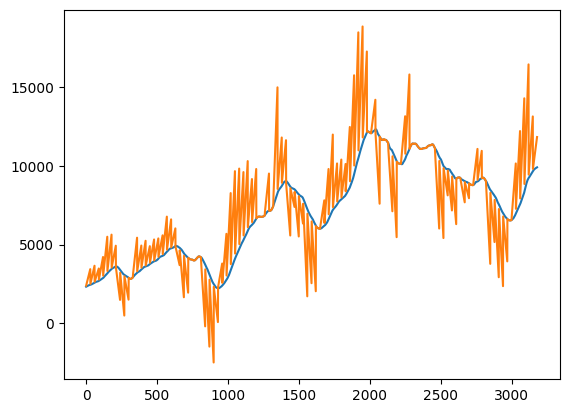

In [137]:
pd.Series(series).plot()
pd.Series(approx_signal).plot()

In [138]:
# ---------------------------
# 1) Markov chain forecasting (1-step rolling)
# ---------------------------
n_states = K
T_hat = estimate_markov_transitions(seg_train_states, n_states)
markov_preds = []
history_last = int(seg_train_states[-1]) if len(seg_train_states) > 0 else 0
for true_next in seg_test_states:
    pred = predict_with_markov(T_hat, history_last, horizon=1)[0]
    markov_preds.append(pred)
    history_last = int(true_next)  # roll with true next (one-step rolling evaluation)
markov_preds = np.array(markov_preds)
markov_acc = (markov_preds == seg_test_states).mean()

# ---------------------------
# 2) HMM forecasting via Baum-Welch
# ---------------------------
if len(seg_train_states) >= 3:
    pi_hat, A_hat, B_hat = baum_welch(
        seg_train_states, K=n_states, n_iter=100, seed=random_state, n_states=n_states
    )
    alpha, beta, gamma, xi = forward_backward(seg_train_states, pi_hat, A_hat, B_hat)
    state_belief = gamma[-1]
    hmm_preds = []
    # rolling one-step evaluation: update with actual next observed segment-state
    for obs_next in seg_test_states:
        next_state_belief = state_belief @ A_hat
        next_obs_dist = next_state_belief @ B_hat
        pred_symbol = int(np.argmax(next_obs_dist))
        hmm_preds.append(pred_symbol)
        like = B_hat[:, int(obs_next)]
        post = next_state_belief * like
        state_belief = post / post.sum() if post.sum() > 0 else np.ones_like(post) / len(post)
    hmm_preds = np.array(hmm_preds)
    hmm_acc = (hmm_preds == seg_test_states).mean()
else:
    hmm_preds = np.array([-1] * len(seg_test_states))
    hmm_acc = np.nan

# ---------------------------
# 3) LSTM categorical forecasting
# ---------------------------
# Prepare training token sequences for next-token prediction
W_ctx = 3  # context window for LSTM classifier
tokens = torch.tensor(seg_train_states, dtype=torch.long)
X_t, Y_t = [], []
for t in range(len(tokens) - W_ctx):
    X_t.append(tokens[t : t + W_ctx])
    Y_t.append(tokens[t + W_ctx])
if len(X_t) > 0:
    X_t = torch.stack(X_t)  # (batch, W_ctx)
    Y_t = torch.stack(Y_t)  # (batch,)
else:
    X_t = torch.zeros((0, W_ctx), dtype=torch.long)
    Y_t = torch.zeros((0,), dtype=torch.long)

device = torch.device("cpu")
model = CatLSTM(vocab_size=n_states, emb=8, hidden=32).to(device)
criterion = nn.CrossEntropyLoss()
optimizer = optim.Adam(model.parameters(), lr=0.05)

# Quick training (toy-size)
if X_t.shape[0] > 0:
    for epoch in range(60):
        model.train()
        optimizer.zero_grad()
        logits = model(X_t.to(device))  # (batch, W, V)
        last_logits = logits[:, -1, :]  # (batch, V)
        loss = criterion(last_logits, Y_t.to(device))
        loss.backward()
        optimizer.step()

# rolling forecast on segment-test using LSTM classifier
lstm_preds = []
# Initialize context with the last W_ctx tokens from train (or pad if too short)
if len(seg_train_states) >= W_ctx:
    context = torch.tensor(seg_train_states[-W_ctx:], dtype=torch.long)
else:
    # pad with first train state to reach W_ctx
    pad = (
        [int(seg_train_states[0])] * (W_ctx - len(seg_train_states))
        if len(seg_train_states) > 0
        else [0] * W_ctx
    )
    context = torch.tensor(pad + list(seg_train_states), dtype=torch.long)

for true_next in seg_test_states:
    ctx = context[-W_ctx:] if len(context) >= W_ctx else context
    with torch.no_grad():
        logits = model(ctx.unsqueeze(0).to(device))[:, -1, :]
        pred = int(torch.argmax(logits, dim=-1).item())
    lstm_preds.append(pred)
    # update context with the *actual* next token so evaluation is one-step rolling with oracle update
    context = torch.cat([context, torch.tensor([int(true_next)], dtype=torch.long)])
lstm_preds = np.array(lstm_preds)
lstm_acc = (lstm_preds == seg_test_states).mean()

In [139]:
import plotly.graph_objects as go

# ---------------------------
# Results & plots
# ---------------------------
print("Number of segments (total):", n_segs)
print("Train segments:", split_seg_index, "Test segments:", len(seg_test_states))
print(f"Markov accuracy: {markov_acc:.4f}")
print(f"HMM accuracy:    {np.nan if np.isnan(hmm_acc) else round(hmm_acc,4)}")
print(f"LSTM accuracy:   {lstm_acc:.4f}")

# build index mapping segments -> series indices for plotting
seg_indices = np.arange(n_segs) * W  # starting sample index for each segment
test_seg_starts = seg_indices[split_seg_index : split_seg_index + len(seg_test_states)]

# ---------------------------
# Plot 1: Training states only
# ---------------------------
fig_train = go.Figure()
fig_train.add_trace(
    go.Scatter(
        x=seg_indices[:split_seg_index],
        y=states[:split_seg_index],
        mode="lines+markers",
        line=dict(shape="hv"),
        name="Train states",
    )
)
fig_train.update_layout(
    title="Segment States (Training)",
    xaxis_title="Series sample index (segment start)",
    yaxis_title="State id",
    template="plotly_white",
    width=800,
    height=400,
)
fig_train.show()

# ---------------------------
# Plot 2: Test states + predictions
# ---------------------------
fig_test = go.Figure()

# True states
fig_test.add_trace(
    go.Scatter(
        x=test_seg_starts,
        y=seg_test_states,
        mode="lines+markers",
        line=dict(shape="hv", color="black"),
        name="True test states",
    )
)

# Predictions
fig_test.add_trace(
    go.Scatter(
        x=test_seg_starts,
        y=markov_preds,
        mode="markers",
        marker=dict(symbol="x", size=10, color="red"),
        name="Markov preds",
    )
)
fig_test.add_trace(
    go.Scatter(
        x=test_seg_starts,
        y=hmm_preds,
        mode="markers",
        marker=dict(symbol="square", size=9, color="orange"),
        name="HMM preds",
    )
)
fig_test.add_trace(
    go.Scatter(
        x=test_seg_starts,
        y=lstm_preds,
        mode="markers",
        marker=dict(symbol="circle", size=9, color="blue"),
        name="LSTM preds",
    )
)

fig_test.update_layout(
    title="Test Segment States and Predictions",
    xaxis_title="Series sample index (segment start)",
    yaxis_title="State id",
    template="plotly_white",
    width=800,
    height=400,
    legend=dict(orientation="h", y=-0.2),
)
fig_test.show()

Number of segments (total): 106
Train segments: 84 Test segments: 22
Markov accuracy: 0.4545
HMM accuracy:    0.3636
LSTM accuracy:   0.3182


In [140]:
# Explain states
explanations = explain_clusters(X_seg, states)

print(f"Optimal clusters: {K}, silhouette={score:.2f}")
for c, desc in explanations.items():
    print(f"State {c}: {desc}")

Optimal clusters: 6, silhouette=0.28
State 0: Strict upward trend
State 1: Strict downward trend
State 2: Strict downward trend (alt 2)
State 3: Strict upward trend (alt 3)
State 4: Strict upward trend (alt 4)
State 5: Strict downward trend (alt 5)


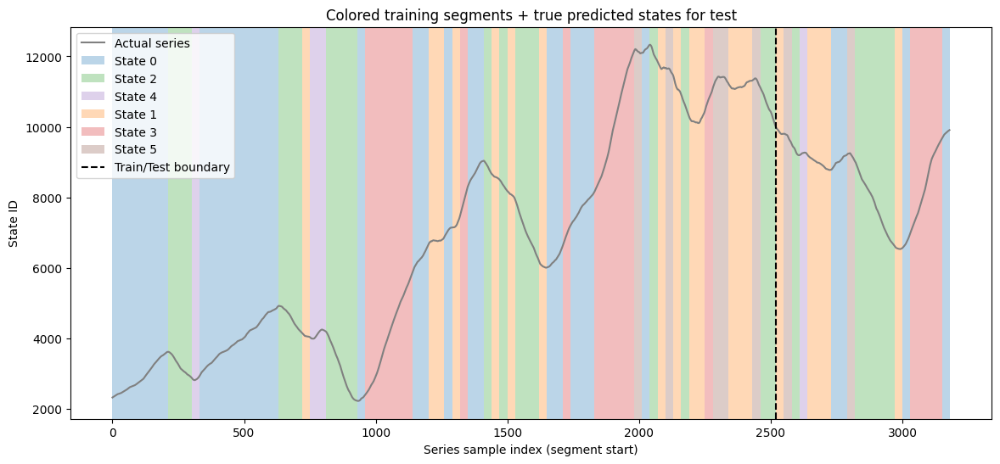

In [141]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Example: assign a distinct color to each unique state
unique_states = np.unique(states)
cmap = plt.get_cmap("tab10")  # categorical colormap
state_colors = {s: cmap(i % 10) for i, s in enumerate(unique_states)}

# Build index mapping segments -> series indices for plotting
seg_indices = np.arange(n_segs) * W  # starting sample index for each segment

plt.figure(figsize=(14, 6))
plt.plot(np.arange(len(series)), series, color="gray", lw=1.5, label="Actual series")
# --- Plot training segments with different colors ---
for i in range(split_seg_index):  # training part
    state = states[i]
    plt.axvspan(
        seg_indices[i],
        seg_indices[i] + W,
        facecolor=state_colors[state],
        alpha=0.3,
        label=(
            f"State {state}"
            if f"State {state}" not in plt.gca().get_legend_handles_labels()[1]
            else ""
        ),
    )

# --- Plot test true states (as faint spans for reference) ---
for i in range(split_seg_index, n_segs):
    state = states[i]
    plt.axvspan(seg_indices[i], seg_indices[i] + W, facecolor=state_colors[state], alpha=0.3)

# Vertical line for train/test boundary
plt.axvline(train_seg_count * W, color="k", linestyle="--", label="Train/Test boundary")

# # --- Overlay predictions for test segments ---
# test_seg_starts = seg_indices[split_seg_index:split_seg_index + len(seg_test_states)]
# plt.scatter(test_seg_starts, markov_preds, marker='x', s=60, c='red', label='Markov preds')
# plt.scatter(test_seg_starts, hmm_preds, marker='s', s=50, c='orange', label='HMM preds')
# plt.scatter(test_seg_starts, lstm_preds, marker='o', s=40, c='blue', label='LSTM preds')

plt.xlabel("Series sample index (segment start)")
plt.ylabel("State ID")
plt.title("Colored training segments + true predicted states for test")
plt.legend()
plt.show()

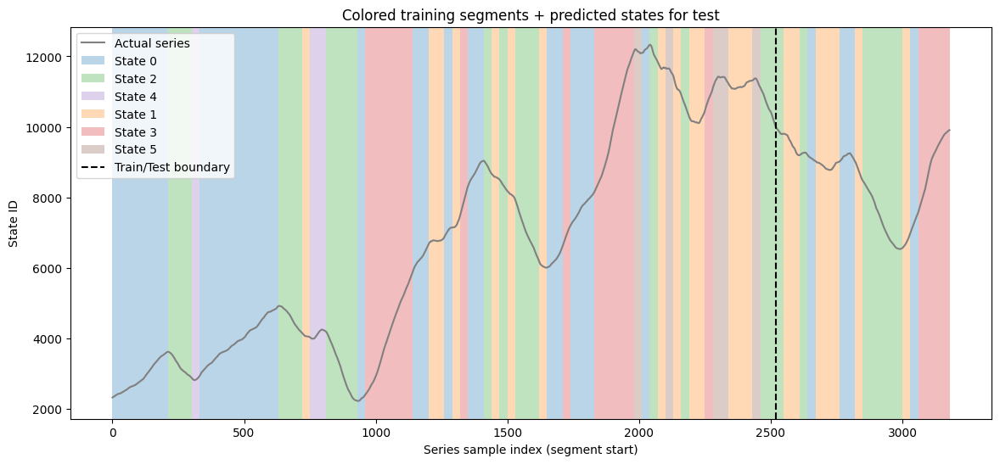

In [142]:
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

# Example: assign a distinct color to each unique state
unique_states = np.unique(states)
cmap = plt.get_cmap("tab10")  # categorical colormap
state_colors = {s: cmap(i % 10) for i, s in enumerate(unique_states)}

# Build index mapping segments -> series indices for plotting
seg_indices = np.arange(n_segs) * W  # starting sample index for each segment

plt.figure(figsize=(14, 6))
plt.plot(np.arange(len(series)), series, color="gray", lw=1.5, label="Actual series")
# --- Plot training segments with different colors ---
for i in range(split_seg_index):  # training part
    state = (seg_train_states.tolist() + markov_preds.tolist())[i]
    plt.axvspan(
        seg_indices[i],
        seg_indices[i] + W,
        facecolor=state_colors[state],
        alpha=0.3,
        label=(
            f"State {state}"
            if f"State {state}" not in plt.gca().get_legend_handles_labels()[1]
            else ""
        ),
    )

# --- Plot test true states (as faint spans for reference) ---
for i in range(split_seg_index, n_segs):
    state = (seg_train_states.tolist() + markov_preds.tolist())[i]
    plt.axvspan(seg_indices[i], seg_indices[i] + W, facecolor=state_colors[state], alpha=0.3)

# Vertical line for train/test boundary
plt.axvline(train_seg_count * W, color="k", linestyle="--", label="Train/Test boundary")

# # --- Overlay predictions for test segments ---
# test_seg_starts = seg_indices[split_seg_index:split_seg_index + len(seg_test_states)]
# plt.scatter(test_seg_starts, markov_preds, marker='x', s=60, c='red', label='Markov preds')
# plt.scatter(test_seg_starts, hmm_preds, marker='s', s=50, c='orange', label='HMM preds')
# plt.scatter(test_seg_starts, lstm_preds, marker='o', s=40, c='blue', label='LSTM preds')

plt.xlabel("Series sample index (segment start)")
plt.ylabel("State ID")
plt.title("Colored training segments + predicted states for test")
plt.legend()
plt.show()

In [143]:
import numpy as np
import plotly.express as px
import plotly.graph_objects as go

# Example data assumptions (replace with yours)
# series, states, seg_test_states, markov_preds, hmm_preds, lstm_preds defined outside
# n_segs, W, split_seg_index, train_seg_count defined outside

unique_states = np.unique(states)
colors = px.colors.qualitative.Plotly  # categorical palette
state_colors = {s: colors[i % len(colors)] for i, s in enumerate(unique_states)}

seg_indices = np.arange(n_segs) * W  # starting sample index for each segment

fig = go.Figure()

# --- Actual full series (gray background line for reference) ---
fig.add_trace(
    go.Scatter(
        x=np.arange(len(series)),
        y=series,
        mode="lines",
        line=dict(color="lightgray", width=1.5, dash="dot"),
        name="Full series",
        showlegend=True,
    )
)

# --- Add each segment as shaded region + sub-series line ---
for i in range(n_segs):
    state = states[i]
    x0, x1 = seg_indices[i], seg_indices[i] + W
    seg_x = np.arange(x0, x1)
    seg_y = series[x0:x1]

    show_legend = True if i == list(states).index(state) else False

    # Shaded region for the state
    fig.add_trace(
        go.Scatter(
            x=[x0, x1, x1, x0],
            y=[min(series), min(series), max(series), max(series)],
            fill="toself",
            fillcolor=state_colors[state],
            opacity=0.25,
            line=dict(width=0),
            name=f"State {state}",
            legendgroup=f"state{state}",
            showlegend=show_legend,
        )
    )

    # Actual sub-series line for this segment
    fig.add_trace(
        go.Scatter(
            x=seg_x,
            y=seg_y,
            mode="lines",
            line=dict(color=state_colors[state], width=2),
            name=f"State {state}",
            legendgroup=f"state{state}",
            showlegend=False,  # already shown in shaded region
        )
    )

# --- Train/Test boundary ---
fig.add_vline(
    x=train_seg_count * W,
    line=dict(color="black", dash="dash"),
    annotation_text="Train/Test boundary",
    annotation_position="top left",
)

# --- Layout ---
fig.update_layout(
    title="Colored training segments + actual sub-series per state",
    xaxis_title="Series sample index (segment start)",
    yaxis_title="Series Value",
    legend=dict(orientation="h", y=-0.2),
)

fig.show()

In [144]:
ds["segment"] = np.repeat(np.arange(ds.shape[0] // W), W)
ds["state"] = ds["segment"].map(X_df.state.to_dict())

In [145]:
import numpy as np
import plotly.express as px

# Filter state == 10
dt = ds[ds.state == 3].copy()

# Add segment ids
n_segments = dt.shape[0] // W
dt["segment"] = np.repeat(np.arange(n_segments), W)
# dt.index = [j for i in range(n_segments) for j in range(W)]
dt.reset_index(inplace=True)

# Scale each segment individually between 0–1
dt["y_scaled"] = dt.groupby("segment")["y"].transform(
    lambda x: (x - x.min()) / (x.max() - x.min())
)

slope = (
    X_df[X_df.state == 2][["slope_sign", "curve_sign", "a", "b", "c", "mu"]]
    .reset_index(drop=True)
    .to_dict()
)
dt["slope_sign"] = dt.state.map(slope["slope_sign"])
dt["curve_sign"] = dt.state.map(slope["curve_sign"])
dt["a"] = dt.state.map(slope["a"])
dt["b"] = dt.state.map(slope["b"])
dt["c"] = dt.state.map(slope["c"])
dt["mu"] = dt.state.map(slope["mu"])

# Plotly line plot
fig = px.line(
    dt,
    x="index",  # keeps alignment with reset index
    y="y_scaled",
    color="segment",
    title="Overlay of sub-series segments (scaled 0–1 independently)",
    hover_data=["slope_sign", "curve_sign", "a", "b", "c", "mu"],
    labels={"index": "Relative index within segment", "y_scaled": "Scaled series value (0–1)"},
)

fig.update_layout(template="plotly_white", legend_title_text="Segment", width=900, height=500)

fig.show()

In [146]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Copy to work on
dt = ds.copy()
dt = dt.sort_values(["segment", "state"]).reset_index(drop=True)

# Add aligned column
dt["y_aligned"] = dt["y"]

for state_id, state_group in dt.groupby("state"):
    prev_last = None
    for seg_id, group in state_group.groupby("segment", sort=True):
        idx = group.index
        if prev_last is not None:
            offset = prev_last - group["y"].iloc[0]
            dt.loc[idx, "y_aligned"] = group["y"] + offset
        prev_last = dt.loc[idx, "y_aligned"].iloc[-1]

# Pick 6 random states
sample_states = dt["state"].sort_values().unique().tolist()

# Create 2x3 subplot with *independent* axes
fig = make_subplots(rows=4, cols=3, subplot_titles=[f"State {s}" for s in sample_states])

# Add traces
row, col = 1, 1
for st in sample_states:
    subset = dt[dt["state"] == st]

    # Original y
    fig.add_trace(
        go.Scatter(
            x=subset["index"],
            y=subset["y"],
            mode="lines",
            line=dict(dash="dot"),
            name="y",
            legendgroup=f"y_{st}",
            showlegend=False,
            marker_color="gray",
        ),
        row=row,
        col=col,
    )

    # Aligned y
    for seg_id, g in subset.groupby("segment"):
        fig.add_trace(
            go.Scatter(
                x=g["index"],
                y=g["y_aligned"],
                mode="lines",
                name=f"seg {seg_id}",
                legendgroup=f"seg_{seg_id}_{st}",
                showlegend=False,
            ),
            row=row,
            col=col,
        )

    # move to next cell
    col += 1
    if col > 3:
        row += 1
        col = 1

fig.update_layout(
    height=700, width=1100, title="Independent Plots: Original vs Aligned Segments per State"
)

fig.show()

In [147]:
import pandas as pd
import plotly.graph_objects as go
from plotly.subplots import make_subplots

# Copy and prepare
dt = ds.copy()
dt = dt.sort_values(["segment", "state"]).reset_index(drop=True)

# Add aligned column
dt["y_aligned"] = dt["y"]

for state_id, state_group in dt.groupby("state"):
    prev_last = None
    for seg_id, group in state_group.groupby("segment", sort=True):
        idx = group.index
        if prev_last is not None:
            offset = prev_last - group["y"].iloc[0]
            dt.loc[idx, "y_aligned"] = group["y"] + offset
        prev_last = dt.loc[idx, "y_aligned"].iloc[-1]

# Reset local x-axis per state by concatenating segments
dt["x_reset"] = 0
for state_id, state_group in dt.groupby("state"):
    x_counter = 0
    for seg_id, group in state_group.groupby("segment", sort=True):
        idx = group.index
        seg_len = len(group)
        dt.loc[idx, "x_reset"] = range(x_counter, x_counter + seg_len)
        x_counter += seg_len

# Pick 6 random states
sample_states = dt["state"].sort_values().unique().tolist()

# Create 2x3 subplot with *independent* axes
fig = make_subplots(rows=2, cols=3, subplot_titles=[f"State {s}" for s in sample_states])

# Add only aligned traces (no original y)
row, col = 1, 1
for st in sample_states:
    subset = dt[dt["state"] == st]

    for seg_id, g in subset.groupby("segment"):
        fig.add_trace(
            go.Scatter(
                x=g["x_reset"],
                y=g["y_aligned"],
                mode="lines",
                name=f"seg {seg_id} (state {st})",
                legendgroup=f"seg_{seg_id}_{st}",
                showlegend=False,
            ),
            row=row,
            col=col,
        )

    # move to next cell
    col += 1
    if col > 3:
        row += 1
        col = 1

fig.update_layout(
    height=800, width=1100, title="Aligned Segments per State (Concatenated, Reset X-axis)"
)

fig.show()

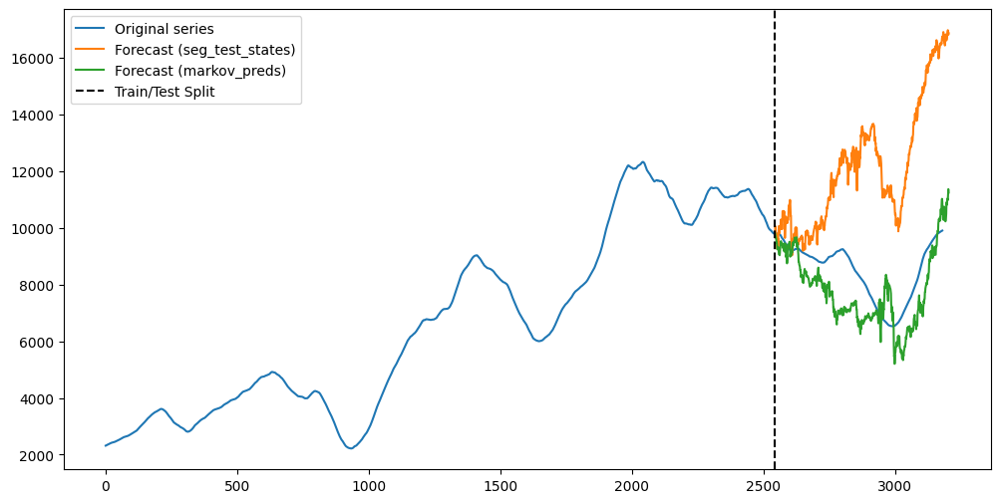

In [150]:
import random

import matplotlib.pyplot as plt

# ---- First forecast (seg_test_states) ----
segment_start = train_series[-1].item()
seg_values = []
for state in seg_test_states:
    next_state_segments = ds[ds.state == state]
    randm_segment_from_state = random.choice(next_state_segments.segment.values)
    curr_segment_values = next_state_segments[
        next_state_segments.segment == randm_segment_from_state
    ]["y"].values
    offset = segment_start - curr_segment_values[0]
    future = curr_segment_values + offset
    seg_values.append(future)
    segment_start = future[-1]

forecast = [j for i in seg_values for j in i]

# ---- Second forecast (markov_preds) ----
segment_start = train_series[-1].item()  # reset here
seg_values_markov = []
for state in markov_preds:
    next_state_segments = ds[ds.state == state]
    randm_segment_from_state = random.choice(next_state_segments.segment.values)
    curr_segment_values = next_state_segments[
        next_state_segments.segment == randm_segment_from_state
    ]["y"].values
    offset = segment_start - curr_segment_values[0]
    future = curr_segment_values + offset
    seg_values_markov.append(future)
    segment_start = future[-1]

forecast_markov_preds = [j for i in seg_values_markov for j in i]

# ---- Plot ----
plt.figure(figsize=(12, 6))
plt.plot(series, label="Original series")
plt.plot(
    range(len(train_series), len(train_series) + len(forecast)),
    forecast,
    label="Forecast (seg_test_states)",
)
plt.plot(
    range(len(train_series), len(train_series) + len(forecast_markov_preds)),
    forecast_markov_preds,
    label="Forecast (markov_preds)",
)
plt.axvline(len(train_series) - 1, color="black", linestyle="--", label="Train/Test Split")
plt.legend()
plt.show()

Test F1 Scores:
Markov: 42.54%
HMM   : 31.82%
LSTM  : 29.39%


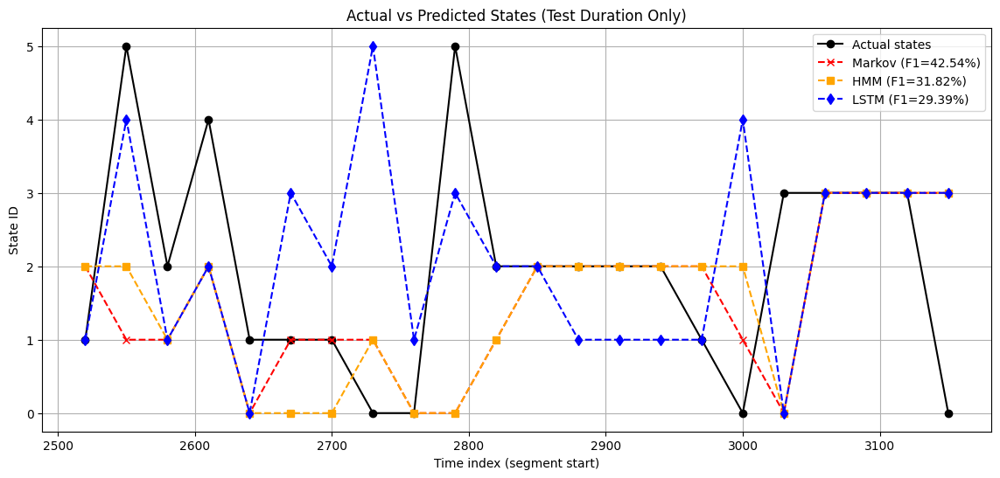

In [149]:
import matplotlib.pyplot as plt
import numpy as np
from sklearn.metrics import f1_score

# ===================
# F1 Score Calculation
# ===================


def f1(true, pred):
    return f1_score(true, pred, average="weighted")  # weighted handles class imbalance


f1_markov = f1(seg_test_states, markov_preds)
f1_hmm = f1(seg_test_states, hmm_preds)
f1_lstm = f1(seg_test_states, lstm_preds)

print("Test F1 Scores:")
print(f"Markov: {f1_markov:.2%}")
print(f"HMM   : {f1_hmm:.2%}")
print(f"LSTM  : {f1_lstm:.2%}")

# ===================
# Plot Actual vs Pred
# ===================
test_seg_starts = seg_indices[split_seg_index : split_seg_index + len(seg_test_states)]

plt.figure(figsize=(14, 6))

# Actual states (baseline)
plt.plot(test_seg_starts, seg_test_states, "-o", color="black", label="Actual states")

# Predictions with F1 scores in legend
plt.plot(test_seg_starts, markov_preds, "x--", color="red", label=f"Markov (F1={f1_markov:.2%})")
plt.plot(test_seg_starts, hmm_preds, "s--", color="orange", label=f"HMM (F1={f1_hmm:.2%})")
plt.plot(test_seg_starts, lstm_preds, "d--", color="blue", label=f"LSTM (F1={f1_lstm:.2%})")

plt.xlabel("Time index (segment start)")
plt.ylabel("State ID")
plt.title("Actual vs Predicted States (Test Duration Only)")
plt.legend()
plt.grid(True)
plt.show()